# Glacial narratives: how can they be captured?

In this notebook, we want to explore how digital methods can help in detecting the narratives that are told about glaciers in different times and places.

In [30]:
import lxml.etree as etree
import os
import pandas as pd
import numpy as np
import wordFrequency as wf
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from math import *



import matplotlib.pyplot as plt
% matplotlib inline

In [4]:
stop_words = {'fr':[], 'de':[], 'en':[]}
stop_words['fr'] = set(stopwords.words('French'))
stop_words['de'] = set(stopwords.words('German'))
stop_words['de'] = set(stopwords.words('English'))

## 1. The TextBerg Corpus
Release 145: http://textberg.ch/site/fr/corpus/ 


In [5]:
list_lang_TextBerg = ['fr', 'de']

In [8]:
def get_content(file_path, lang):

    r_articles = {}

    try:
        tree = etree.parse(file_path)
        root = tree.getroot()

        for art in root.findall('./article'):

            try:
                art_lang = art.find('tocEntry').get('lang')

                if art_lang == lang:
                    art_id = art.get('n')
                    sentences = {}
                    sentences['tagged'] = {}
                    sentences['raw'] = {}
                    for s in art.findall('./div/s[@lang="'+art_lang+'"]'):
                        s_id = s.get('n')
                        sentences['tagged'][s_id] = ''
                        sentences['raw'][s_id] = ''
                        
                        for w in s.findall('w'):
                            sentences['raw'][s_id] += w.text + ' '
                            sentences['tagged'][s_id] += w.text + '/' + str(w.get('pos')) + ' '

                    r_articles[art_id] = sentences
            except AttributeError as e:
                pass #print(str(e))
    except etree.XMLSyntaxError as e:
        pass #print(str(e))

    return r_articles


def getTxtFromArticle(article):
    text = ''
    for s in article.values():
        text += s + ' '
    return text



def removeStopwords(wordlist, stopwords):
    return ' '.join([w for w in wordlist if w.lower() not in stopwords])


""" return the cumulative frequency of a list of words given in parameters """
def wordFrequency(text, words, lang):
    nb = 0
    for word in words:
        if lang == 'de':
            nb += text.count(word)
        else:
            nb += wf.stripNonAlphaNum(text).count(word)
    return nb

#wordFrequency('Je descends des glaciers et du glacier', ['glacier', 'glaciers'], 'fr')


### 1.1 Load the data
Load the content from XML files of the TextBerg Corpus

In [9]:
books = []
list_year = set()

input_path = '/Users/lmoncla/Documents/Data/Corpus/Text+Berg_Release_145/XML/'

print('loading:', end=' ')
for doc in os.listdir(input_path):
    file_id = doc[:-4]
    extension = doc[-4:]
    postfix = file_id[-4:]
    year = file_id[file_id.find('_')+1:file_id.rfind('_')]
 
    if extension == '.xml' and postfix != '-ner':
        list_year.add(year)
        print(file_id, end=' ')
        content = {}
        for lang in list_lang_TextBerg:
            articles = get_content(input_path + doc, lang)
            for article_id, article in articles.items():              
                content[lang] = {}
                content[lang]['file'] = file_id
                content[lang]['year'] = year
                content[lang]['lang'] = lang
                content[lang]['article_id'] = article_id
                textContent = getTxtFromArticle(article['raw'])
                content[lang]['content_txt'] = textContent
       
                content[lang]['content_processed'] = removeStopwords(textContent.split(), stop_words[lang]) # without stopwords
                content[lang]['content_tagged'] = getTxtFromArticle(article['tagged'])
                #get only verbs and adjectives 
                #content[lang]['content_verbAdj'] = get_contentVerbAdj(input_path + doc, lang, article_id)
                
                if lang == 'fr':
                    content[lang]['freq_glacier'] = wordFrequency(textContent, ['glacier', 'glaciers'], lang)
                elif lang == 'de':   
                    content[lang]['freq_glacier'] = wordFrequency(textContent, ['gletscher'], lang)
                    
                books.append(content[lang])      
print('')
list_year = sorted(list_year)

loading: SAC-Jahrbuch_1995_de SAC-Jahrbuch_1999_de SAC-Jahrbuch_1867_mul SAC-Jahrbuch_1877_mul SAC-Jahrbuch_1987_de SAC-Jahrbuch_1942_mul SAC-Jahrbuch_1952_mul SAC-Jahrbuch_1980_fr SAC-Jahrbuch_1883_mul SAC-Jahrbuch_1893_mul SAC-Jahrbuch_1992_fr SAC-Jahrbuch_1920_mul SAC-Jahrbuch_1930_mul SAC-Jahrbuch_2001_de SAC-Jahrbuch_1906_mul SAC-Jahrbuch_1916_mul SAC-Jahrbuch_1974_de SAC-Jahrbuch_1966_de SAC-Jahrbuch_1957_fr SAC-Jahrbuch_1978_de SAC-Jahrbuch_1961_fr SAC-Jahrbuch_1939_mul SAC-Jahrbuch_1929_mul SAC-Jahrbuch_1973_fr SAC-Jahrbuch_2006_fr SAC-Jahrbuch_1917_mul SAC-Jahrbuch_1907_mul SAC-Jahrbuch_1964_de SAC-Jahrbuch_1968_de SAC-Jahrbuch_1959_fr SAC-Jahrbuch_2003_de SAC-Jahrbuch_1976_de SAC-Jahrbuch_1971_fr SAC-Jahrbuch_2004_fr SAC-Jahrbuch_1928_mul SAC-Jahrbuch_1938_mul SAC-Jahrbuch_1963_fr SAC-Jahrbuch_2008_fr SAC-Jahrbuch_1985_de SAC-Jahrbuch_1997_de SAC-Jahrbuch_1876_mul SAC-Jahrbuch_1866_mul SAC-Jahrbuch_1989_de SAC-Jahrbuch_1892_mul SAC-Jahrbuch_1882_mul SAC-Jahrbuch_1953_mul SAC-

In [31]:
# load the data in a dataframe
df_TextBerg = pd.DataFrame(books)
df_TextBerg = df_TextBerg.sort_values(by=['year', 'article_id']).reset_index(drop=True)
df_TextBerg.head()

,article_id,content_processed,content_tagged,content_txt,file,freq_glacier,lang,year
0,1,Chronik des Club . Seit einer Reihe von Jahren...,Chronik/NN des/ART Club/NN ./$. Seit/APPR ein...,Chronik des Club . Seit einer Reihe von Jahre...,SAC-Jahrbuch_1864_mul,0,de,1864
1,10,"Passage col l1 Alphubel . ( 3802 M. = 11,704 P...",Le/D_def Passage/N_C du/P col/N_C de/P l1/N_P ...,Le Passage du col de l1 Alphubel . ( 3802 M. ...,SAC-Jahrbuch_1864_mul,17,fr,1864
2,11,3 . Das Mattwaldhorn und sein Panorama . ( 327...,3/CARD ./$. Das/ART Mattwaldhorn/NE und/KON ...,3 . Das Mattwaldhorn und sein Panorama . ( ...,SAC-Jahrbuch_1864_mul,10,de,1864
3,12,"Der Piz Morteratsch . ( 3754 M. = 11,556 P. F....",Der/ART Piz/NE Morteratsch/NE ./$. (/$( 3754/...,"Der Piz Morteratsch . ( 3754 M. = 11,556 P. F...",SAC-Jahrbuch_1864_mul,13,de,1864
4,13,"Der Piz Tremoggia . ( 3452 M.10,627 P. F. ) Vo...",Der/ART Piz/NE Tremoggia/NE ./$. (/$( 3452/CA...,"Der Piz Tremoggia . ( 3452 M.10,627 P. F. ) V...",SAC-Jahrbuch_1864_mul,1,de,1864


In [38]:
# some tests for filtering based on POS
sent = " ".join(content for content in df_TextBerg.loc[(df_TextBerg['article_id'] == '10') & (df_TextBerg['year'] == '1864')]['content_tagged'])

tagged = [nltk.tag.str2tuple(t) for t in sent.split()]
" ".join([word for (word, tag) in tagged if tag == 'V' or tag == 'A_QUAL']) # get only verbs and adjectives

'd. est contredit offre variés frappants rende verra méridionale atteigne latérales prendra est rencontrent sombres septentrionaux est attire vont grandes classique cède offre variés grandioses a pu contempler semblables aimeles revoir lasse promener trouve aboutissent avoir ai éprouvé retourner passant avais fait ai fait partant central variées offre magnifique blanche a être principale veulent aller passer mauvais avait forcé renoncer dernier étais promia oublier est traversées remarquables sépare fut véritable apprêtai faire croyais toucher charmant puisse trouver hôtelier vint entretenir nouveau aller laissait furent faits étaient fut impossible résister voir prendre pris incontinent redescendis avoir chargé nécessaires passer possible partîmes avais rencontré allions fut convenu unirions bonne mauvaise était commune tempéré légère était chaud tiède semblait beau avais vu étoffe grossière paraissaient heureux blonds grosses avaient faisait voir aurais voulu pouvoir rester invisible

In [20]:
# test nltk concordance
text = " ".join(content for content in df_TextBerg.loc[(df_TextBerg['article_id'] == '10') & (df_TextBerg['year'] == '1864')]['content_txt'])

text2 = nltk.Text(nltk.word_tokenize(text))
 
match = text2.concordance('glacier')

Displaying 10 of 10 matches:
evl ' extrémité du vallon , le beau glacier de Längenfluh se montre on ne peut 
roite , VAllelin-Pass , traverse le glacier de Mellichen et se dirige sur Mattm
Le second , à gauche , passe sur le glacier de Wand et conduit à Fée . Ce derni
 , ainsi qu ' il avait convenu . Le glacier de Wand n ' est pas trop rapide ; a
e ces chants nationaux . Le superbe glacier de Fée s ' étendait à nos pieds . C
n de s ' en garantir . Au centre du glacier , des crevasses sans fond ouvraient
lement ramolli les . neiges dont le glacier est couvert , que , ça et là , nous
mparer à ette oasis que l ' immence glacier de Fée entame de ses bras vigoureux
oleil avait une telle action sur le glacier , que tes innocents petits courants
spendue sur ce riant séjour . Si le glacier par lequel nous venons d ' arriver 


### 1.2. Data exploration

In [21]:
# shows the number of articles per language

df_TextBerg['lang'].value_counts()

de    9917
fr    5988
Name: lang, dtype: int64

In [22]:
# shows the number of articles containing the word glacier

df_TextBerg_glacier = df_TextBerg.loc[df_TextBerg['freq_glacier']>0]
len(df_TextBerg_glacier)

5277

In [23]:
# shows the number of articles containing the word glacier per language

df_TextBerg_glacier['lang'].value_counts()

de    2855
fr    2422
Name: lang, dtype: int64

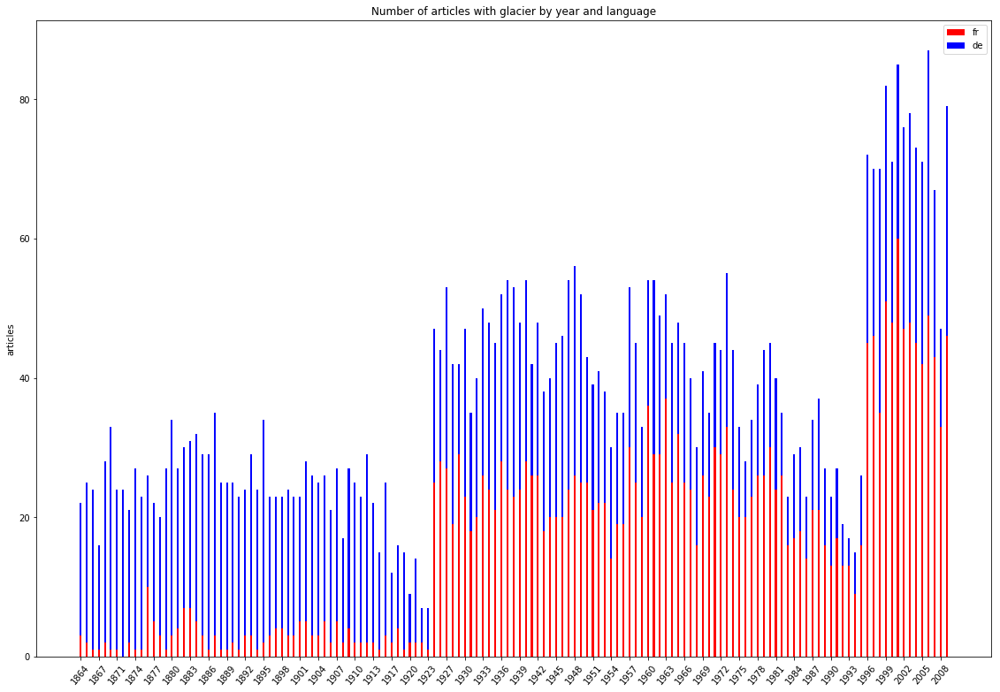

In [24]:
# get number of articles containing glacier per year and language

freq = {'fr':[], 'de':[]}
for y in list_year:
    for l in list_lang_TextBerg:
        d = df_TextBerg_glacier.loc[(df_TextBerg_glacier['year']==y) & (df_TextBerg_glacier['lang']==l)]
        if not d.empty:
            freq[l].append(len(d.index))
        else:
            freq[l].append(0)
            
# plots the number of articles containing glacier per year and language

fig = plt.figure(figsize=(15,10))
ax = fig.add_axes([0,0,1,1])
ax.bar(list_year, freq['fr'], 0.3, color='r')
ax.bar(list_year, freq['de'], 0.3, bottom=freq['fr'], color='b')
ax.set_ylabel('articles')
ax.set_title('Number of articles with glacier by year and language')
ax.legend(labels=list_lang_TextBerg)
plt.xticks(np.arange(len(list_year)/3)*3)
plt.xticks(rotation=50)
plt.show()

### 1.3. Word Frequency

In [25]:
# declare wordclouds with their parameters for each language
wc = {}
wc['fr'] = WordCloud(stopwords=stop_words['fr'], max_font_size=70, max_words=100, background_color="white")
wc['de'] = WordCloud(stopwords=stop_words['de'], max_font_size=70, max_words=100, background_color="white")

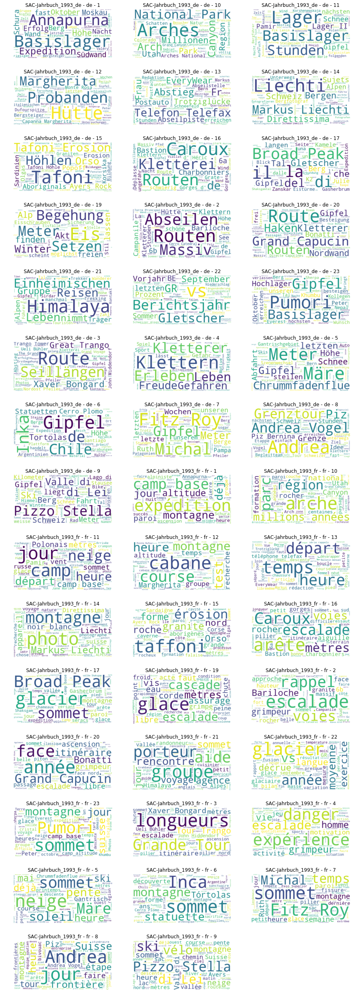

In [64]:
# wordcloud for each article of a given year

y = '1993'
df_TextBerg_test = df_TextBerg.loc[df_TextBerg['year'] == y].reset_index(drop=True)
nbColumns  = 3
nbRows = ceil(len(df_TextBerg_test)/nbColumns) # get the number of rows for subplot

plt.figure(figsize=(5*nbColumns,3*nbRows))
for index, row in df_TextBerg_test.iterrows():
    wordcloud = wc[row['lang']].generate(row['content_txt'])
    plt.subplot(nbRows, nbColumns, index+1)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(row['file'] +' - ' + row['lang'] +' - '+ row['article_id'])
    plt.axis('off')

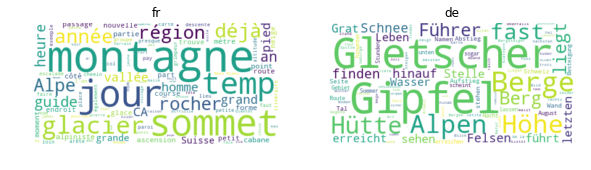

In [24]:
# wordcloud of all articles per language

nbColumns  = 3
nbRows = ceil(len(list_lang_TextBerg)/nbColumns) # get the number of rows for subplot

plt.figure(figsize=(5*nbColumns,3*nbRows))

for index, lang in enumerate(list_lang_TextBerg):
    text = " ".join(content for content in df_TextBerg.loc[df_TextBerg['lang'] == lang].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index+1)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang)
    plt.axis('off')

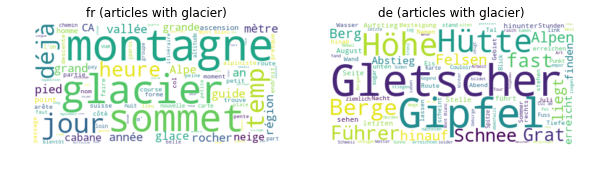

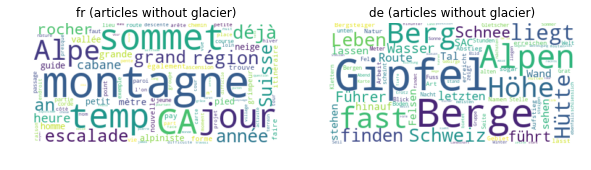

In [65]:
# wordcloud of all articles per language

nbColumns  = 3
nbRows = ceil(len(list_lang_TextBerg)/nbColumns) # get the number of rows for subplot

plt.figure(figsize=(5*nbColumns,3*nbRows))

for index, lang in enumerate(list_lang_TextBerg):
    text = " ".join(content for content in df_TextBerg_glacier.loc[df_TextBerg_glacier['lang'] == lang].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index+1)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang + ' (articles with glacier)')
    plt.axis('off')


# wordcloud of all articles not containing the word 'glacier' per language 
df_TextBerg_without_glacier = df_TextBerg.loc[df_TextBerg['freq_glacier']==0].reset_index(drop=True)

plt.figure(figsize=(5*nbColumns,3*nbRows))

for index, lang in enumerate(list_lang_TextBerg):
    text = " ".join(content for content in df_TextBerg_without_glacier.loc[df_TextBerg_without_glacier['lang'] == lang].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index+1)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang+ ' (articles without glacier)')
    plt.axis('off')

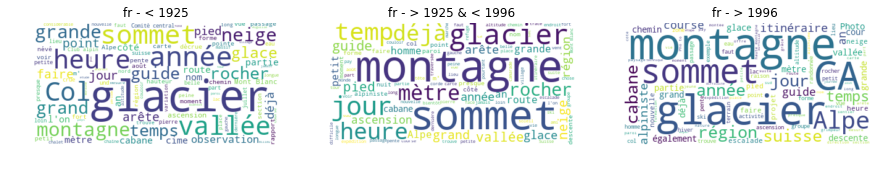

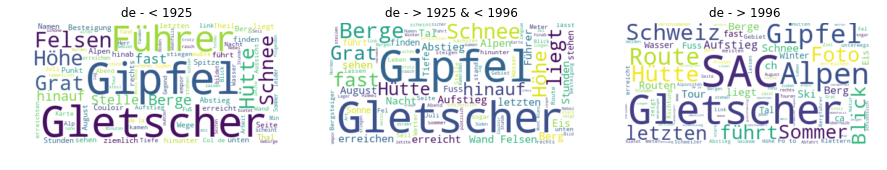

In [70]:
# wordcloud of all articles containing glacier for different period of time

for lang in list_lang_TextBerg:
    index = 1
    df = df_TextBerg_glacier.loc[df_TextBerg_glacier['lang'] == lang]
       
    nbColumns  = 3
    nbRows = 1
    
    plt.figure(figsize=(5*nbColumns,3*nbRows))
    

    text = " ".join(content for content in df.loc[df['year'] < '1925'].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang + ' - < 1925')
    plt.axis('off')
    
    text = " ".join(content for content in df.loc[(df['year'] >= '1925') & (df['year'] < '1996')].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index+1)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang +' - > 1925 & < 1996')
    plt.axis('off')
    
    text = " ".join(content for content in df.loc[df['year'] >= '1996'].content_txt)
    wordcloud = wc[lang].generate(text)
    plt.subplot(nbRows, nbColumns, index+2)
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.title(lang +' - > 1996 ')
    plt.axis('off')

(-0.5, 399.5, 199.5, -0.5)

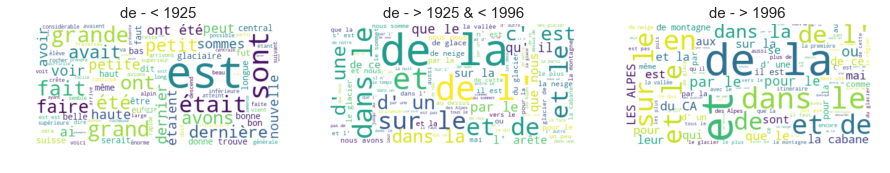

In [46]:
# wordcloud of all articles containing glacier for different period of time

#for lang in list_lang_TextBerg:
index = 1
df = df_TextBerg_glacier.loc[df_TextBerg_glacier['lang'] == 'fr']

nbColumns  = 3
nbRows = 1

plt.figure(figsize=(5*nbColumns,3*nbRows))


text = " ".join(content for content in df.loc[df['year'] < '1925'].content_tagged)

tagged = [nltk.tag.str2tuple(t) for t in text.split()]
text = " ".join([word for (word, tag) in tagged if tag == 'V' or tag == 'A_QUAL']) # get only verbs and adjectives


wordcloud = wc[lang].generate(text)
plt.subplot(nbRows, nbColumns, index)
plt.imshow(wordcloud, interpolation='bilinear') 
plt.title(lang + ' - < 1925')
plt.axis('off')

text = " ".join(content for content in df.loc[(df['year'] >= '1925') & (df['year'] < '1996')].content_txt)
wordcloud = wc[lang].generate(text)
plt.subplot(nbRows, nbColumns, index+1)
plt.imshow(wordcloud, interpolation='bilinear') 
plt.title(lang +' - > 1925 & < 1996')
plt.axis('off')

text = " ".join(content for content in df.loc[df['year'] >= '1996'].content_txt)
wordcloud = wc[lang].generate(text)
plt.subplot(nbRows, nbColumns, index+2)
plt.imshow(wordcloud, interpolation='bilinear') 
plt.title(lang +' - > 1996 ')
plt.axis('off')


        

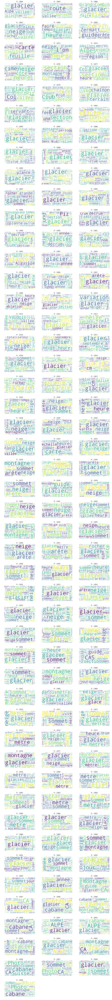

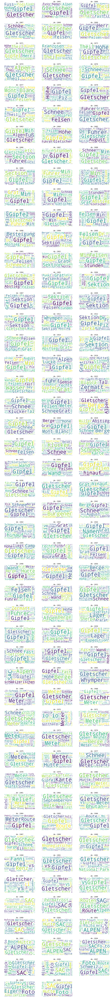

In [16]:
# wordcloud of all articles containing glacier for each year


for lang in list_lang_TextBerg:

    df = df_TextBerg_glacier.loc[df_TextBerg_glacier['lang'] == lang]
       
    nbColumns  = 3
    nbRows = ceil(df['year'].nunique()/nbColumns) # get the number of rows for subplot

    plt.figure(figsize=(5*nbColumns,3*nbRows))
    for index, year in enumerate(list(df['year'].unique())):
        df1 = df.loc[df_TextBerg_glacier['year'] == year]
        text = " ".join(content for content in df1.content_txt)
    
        wordcloud = wc[lang].generate(text)
        plt.subplot(nbRows, nbColumns, index+1)
        plt.imshow(wordcloud, interpolation='bilinear') 
        plt.title(lang + ' - ' + year)
        plt.axis('off')

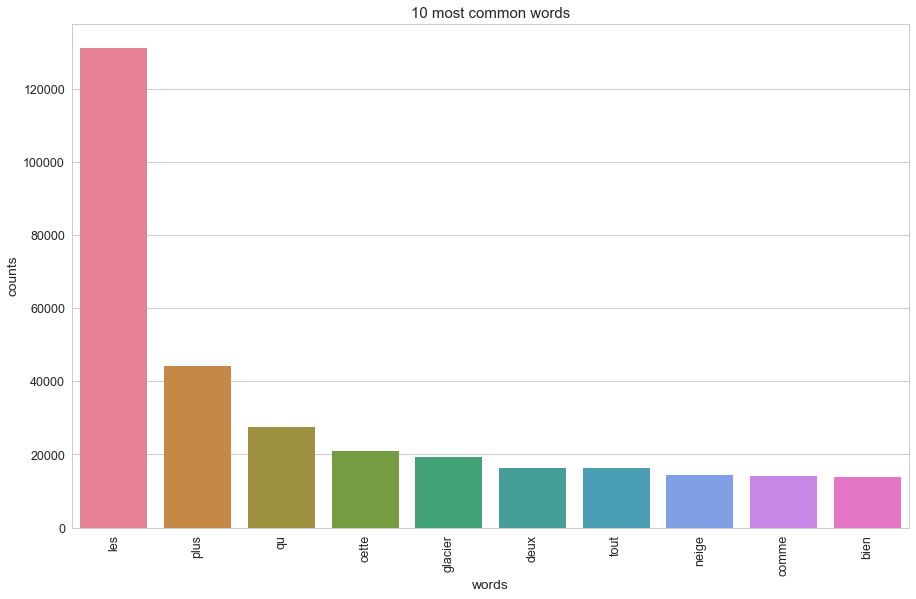

In [28]:
# Load the library with the CountVectorizer method
from sklearn.feature_extraction.text import CountVectorizer

import seaborn as sns
sns.set_style('whitegrid')


def plot_10_most_common_words(count_data, count_vectorizer):
    words = count_vectorizer.get_feature_names()
    total_counts = np.zeros(len(words))
    for t in count_data:
        total_counts+=t.toarray()[0]
    
    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:10]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words)) 
    
    plt.figure(2, figsize=(15, 15/1.6180))
    plt.subplot(title='10 most common words')
    sns.set_context("notebook", font_scale=1.25, rc={"lines.linewidth": 2.5})
    sns.barplot(x_pos, counts, palette='husl')
    plt.xticks(x_pos, words, rotation=90) 
    plt.xlabel('words')
    plt.ylabel('counts')
    plt.show()# Initialise the count vectorizer with the English stop words
    
df = df_TextBerg_glacier.loc[df_TextBerg_glacier['lang'] == 'fr']
    
count_vectorizer = CountVectorizer(stop_words=stop_words)# Fit and transform the processed titles
count_data = count_vectorizer.fit_transform(df['content_processed'])# Visualise the 10 most common words
plot_10_most_common_words(count_data, count_vectorizer)

In [29]:
#https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0
import warnings
warnings.simplefilter("ignore", DeprecationWarning)# Load the LDA model from sk-learn
from sklearn.decomposition import LatentDirichletAllocation as LDA
 
# Helper function
def print_topics(model, count_vectorizer, n_top_words):
    words = count_vectorizer.get_feature_names()
    for topic_idx, topic in enumerate(model.components_):
        print("\nTopic #%d:" % topic_idx)
        print(" ".join([words[i]
                        for i in topic.argsort()[:-n_top_words - 1:-1]]))
        
# Tweak the two parameters below
number_topics = 5
number_words = 10# Create and fit the LDA model
lda = LDA(n_components=number_topics, n_jobs=-1)
lda.fit(count_data)# Print the topics found by the LDA model
print("Topics found via LDA:")
print_topics(lda, count_vectorizer, number_words)

Topics found via LDA:

Topic #0:
cabane cas piz les une col section un cabanes tél

Topic #1:
les camp sommet expédition deux mètres plus ils ascension équipe

Topic #2:
les glacier glaciers 10 plus alpes qu cette années glace

Topic #3:
les nom qu mont plus vallée alpes cette col valais

Topic #4:
les plus qu cette tout bien deux où comme neige
